In [1]:
import jax
from jax.config import config
config.update("jax_enable_x64", True)

In [2]:
import scanpy as sc
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import moscot
from moscot.problems.time import TemporalProblem
import moscot.plotting as mpl
import pandas as pd
import os

import mplscience

mplscience.available_styles()
mplscience.set_style(reset_current=True)
plt.rcParams['legend.scatterpoints'] = 1 

/home/icb/dominik.klein/miniconda3/envs/jax_gpu3/lib/python3.8/site-packages/docrep/decorators.py:43: SyntaxWarning: 'parallel_kwargs' is not a valid key!
  doc = func(self, args[0].__doc__, *args[1:], **kwargs)


['default', 'despine']


In [3]:
output_dir = "."

In [4]:
adata_shared_embedding = sc.read_h5ad("/lustre/groups/ml01/workspace/moscot_paper/pancreas/embeddings/pancreas_shared_embeddings.h5ad")

In [5]:
adata = sc.read_h5ad("/lustre/groups/ml01/workspace/moscot_paper/pancreas/pancreas_multiome_2022_processed.h5ad")

In [6]:
adata_imputed_counts = sc.read_h5ad("/lustre/groups/ml01/workspace/moscot_paper/pancreas/embeddings/pancreas_ATAC_imputation.h5ad")

In [7]:
adata_imputed_counts.layers["log_imputed"] = sc.pp.log1p(adata_imputed_counts.layers["X_normalized"])

In [8]:
gene_names = adata[:,adata.var["modality"]=="GEX"].var_names

In [9]:
adata = adata[:, adata.var_names.isin(list(gene_names)+list(adata_imputed_counts.var.index))].copy()

In [10]:
adata.layers["ATAC_imputed"] = np.hstack((sc.pp.log1p(adata[:, adata.var["modality"]=="GEX"].X.A), adata_imputed_counts.layers["log_imputed"]))

In [11]:
new_annotation = pd.read_csv("../EDA/endocrine_refinement.csv")

In [12]:
adata.obs["Fev_delta_refinement"] = new_annotation["Fev_delta_refinement"].values
adata.obs["Ngn3_high_refinement"] = new_annotation["Ngn3_high_refinement"].values

In [13]:
endocrine_celltypes = [
    "Ngn3 low",
    "Ngn3 high",
    "Ngn3 high cycling",
    "Fev+",
    "Fev+ Alpha",
    "Fev+ Beta",
    "Fev+ Delta",
    "Eps. progenitors",
    "Alpha",
    "Beta",
    "Delta",
    "Epsilon"
]

In [14]:
adata_red = adata[adata.obs["celltype"].isin(endocrine_celltypes)].copy()
adata_shared_embedding_red = adata_shared_embedding[adata_shared_embedding.obs["celltype"].isin(endocrine_celltypes)].copy()

In [15]:
sc.tl.umap(adata_red)

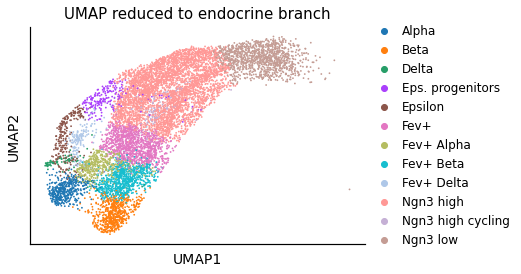

In [16]:
sc.pl.umap(adata_red, color="celltype", title="UMAP reduced to endocrine branch")

In [17]:
adata_red.obs['time'] = adata.obs.apply(lambda x: 14.5 if x["sample"]=="E14.5" else 15.5, axis=1)

In [18]:
def create_col(x):
    if x["celltype"] == "Ngn3 high":
        return x["Ngn3_high_refinement"]
    if x["celltype"] == "Fev+ Delta":
        return x["Fev_delta_refinement"]
    return x["celltype"]

adata_red.obs["refinement"] = adata_red.obs.apply(create_col, axis=1)

In [19]:
def create_col2(x):
    if x["refinement"] in ["Ngn3 high,0", "Ngn3 high,1", "Ngn3 high,2", "Ngn3 high,3", "Ngn3 high,4"]:
        return "Ngn3 high rest"
    return x["refinement"]

adata_red.obs["refinement_grouped"] = adata_red.obs.apply(create_col2, axis=1)

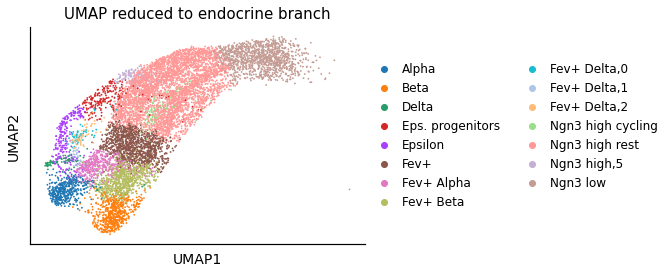

In [20]:
fig = sc.pl.umap(adata_red, color="refinement_grouped", title="UMAP reduced to endocrine branch", show=False)

In [21]:
fig.figure.savefig(os.path.join(output_dir, 'umap_endocrine_refinement_grouped.png'))

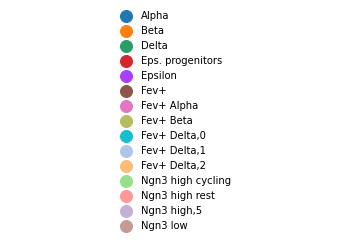

In [22]:
label_params = fig.get_legend_handles_labels() 
figl, axl = plt.subplots()
axl.axis(False)
axl.legend(*label_params, fontsize=5, loc="center", markerscale=2, bbox_to_anchor=(0.5, 0.5), prop={"size":10})

In [23]:
axl.figure.savefig(os.path.join(output_dir, 'endocrine_refinement_grouped_legend_only.png'))

# Heat kernel distances

In [24]:
import pygsp

In [25]:
sc.pp.neighbors(adata_shared_embedding_red, use_rep="X_multi_vi", key_added="multi_vi", n_neighbors=30)

In [26]:
cell_ids_source = adata_red[adata_red.obs["time"]==14.5].obs_names
cell_ids_target = adata_red[adata_red.obs["time"]==15.5].obs_names

In [27]:
assert (adata_red.obs.iloc[:(len(cell_ids_source))].index == cell_ids_source).all()
assert (adata_red.obs.iloc[(len(cell_ids_source)):].index == cell_ids_target).all()

In [28]:
G = pygsp.graphs.Graph(adata_shared_embedding_red.obsp["multi_vi_connectivities"])

In [29]:
G.estimate_lmax()

In [30]:
filt = pygsp.filters.Heat(G, tau=100)
diffusion_distances = filt.filter(np.eye(len(adata_red)))
custom_cost = pd.DataFrame(data=-np.log(diffusion_distances[:len(cell_ids_source), len(cell_ids_source):].copy())+1e-15, index=cell_ids_source, columns=cell_ids_target)

In [31]:
tp0 = TemporalProblem(adata_red)
tp0 = tp0.prepare("time", joint_attr="X_pca") # joint_attr does not matter here

In [32]:
tp0[14.5, 15.5].set_xy(custom_cost, tag="cost")

In [33]:
tp0 = tp0.solve(max_iterations=1e8)

INFO     Solving problem BirthDeathProblem[stage='prepared', shape=(5539, 3826)].            


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

In [34]:
order_celltypes = ['Ngn3 low', 'Ngn3 high cycling', 'Ngn3 high', 'Eps. progenitors', 'Fev+', 'Fev+ Alpha', 
                   'Fev+ Beta', 'Fev+ Delta', 'Alpha', 'Beta', 'Delta', 'Epsilon']

In [35]:
_ = tp0.cell_transition(14.5, 15.5, {"celltype": order_celltypes}, {"celltype": order_celltypes}, forward=False)

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

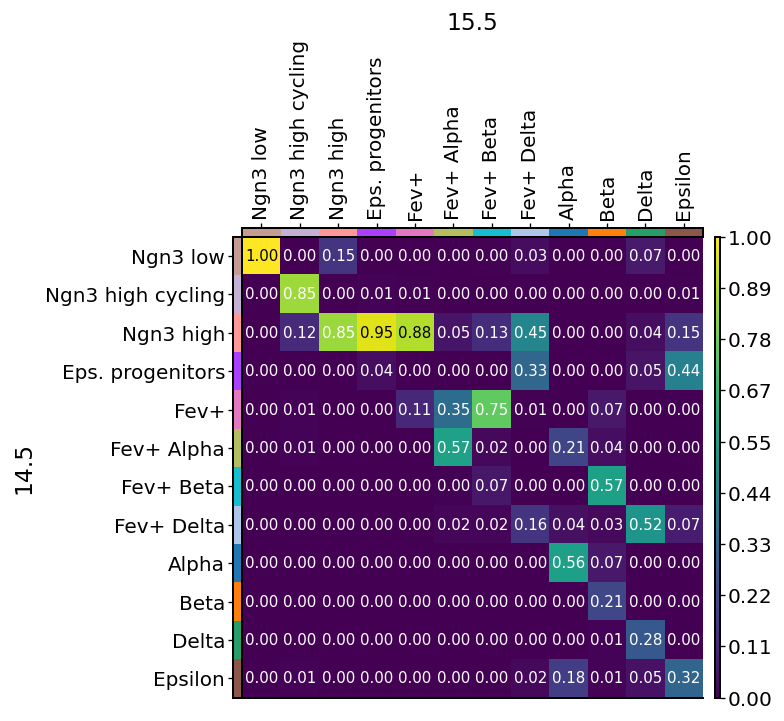

In [36]:
mpl.cell_transition(tp0, dpi=120, fontsize=9)

In [37]:
tp0.pull(14.5, 15.5, data="celltype", subset="Delta", key_added="Delta_pull")

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

# Delta

In [39]:
delta_drivers = tp0.compute_feature_correlation(obs_key="Delta_pull", layer="ATAC_imputed")

In [40]:
delta_drivers

,Delta_pull_corr,Delta_pull_pval,Delta_pull_qval,Delta_pull_ci_low,Delta_pull_ci_high
Sst,0.556047,0.000000e+00,0.000000e+00,NaN,NaN
Hhex,0.430505,0.000000e+00,0.000000e+00,NaN,NaN
Spock3,0.296914,8.139772e-193,3.811557e-188,NaN,NaN
Mef2c,0.296546,2.587917e-192,9.088699e-188,NaN,NaN
Masp1,0.282565,8.535002e-174,2.397977e-169,NaN,NaN
...,...,...,...,...,...
4-8926960-8927804,-0.110872,4.668933e-27,1.306548e-24,NaN,NaN
4-120277112-120278066,-0.112313,9.975821e-28,3.107302e-25,NaN,NaN
12-17575670-17576492,-0.113488,2.791117e-28,9.425322e-26,NaN,NaN
Setbp1,-0.115443,3.254291e-29,1.255933e-26,NaN,NaN


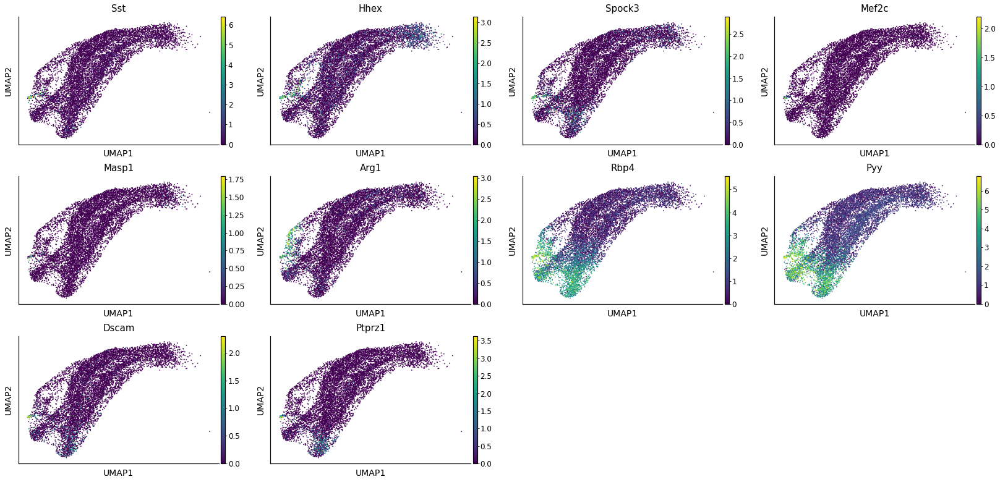

In [41]:
sc.pl.umap(adata_red, layer="ATAC_imputed", color=delta_drivers.index[:10])

In [42]:
delta_drivers_tfs = tp0.compute_feature_correlation(obs_key="Delta_pull", layer="ATAC_imputed", features="mouse")

In [43]:
delta_drivers_tfs

,Delta_pull_corr,Delta_pull_pval,Delta_pull_qval,Delta_pull_ci_low,Delta_pull_ci_high
Hhex,0.430505,0.000000e+00,0.000000e+00,NaN,NaN
Mef2c,0.296546,2.587917e-192,1.718377e-189,NaN,NaN
Arg1,0.240937,5.384605e-125,2.383585e-122,NaN,NaN
Isl1,0.214332,1.673964e-98,5.557562e-96,NaN,NaN
Meis2,0.130879,3.703193e-37,8.196400e-35,NaN,NaN
...,...,...,...,...,...
Sox4,-0.090488,1.643847e-18,1.819191e-16,NaN,NaN
Nkx2-2,-0.095148,2.601750e-20,3.455124e-18,NaN,NaN
Neurog3,-0.110209,9.431263e-27,1.565590e-24,NaN,NaN
Setbp1,-0.115443,3.254291e-29,6.173855e-27,NaN,NaN


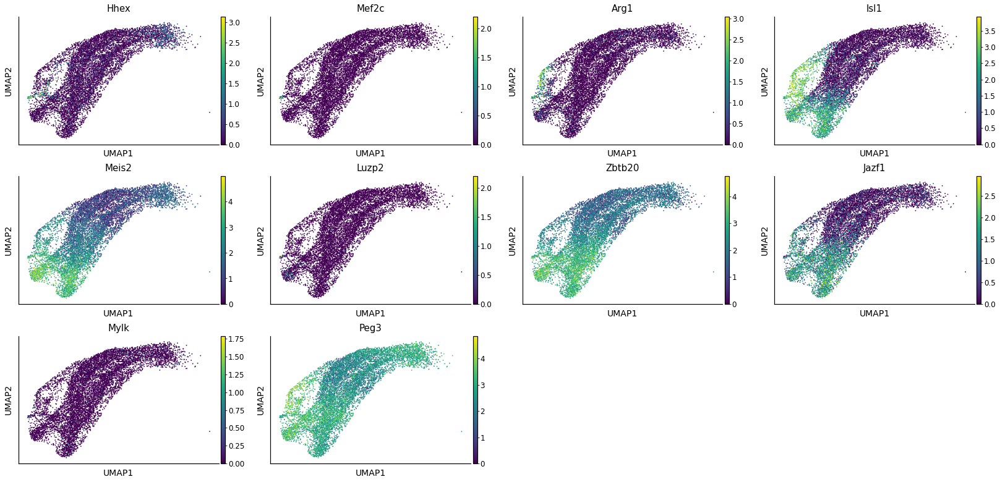

In [44]:
sc.pl.umap(adata_red, layer="ATAC_imputed", color=delta_drivers_tfs.index[:10])

In [52]:
peaks = list(adata[:,adata.var["modality"]=="ATAC"].var_names)

In [63]:
genes = list(adata[:,adata.var["modality"]=="GEX"].var_names)

In [53]:
delta_drivers_peaks = tp0.compute_feature_correlation(obs_key="Delta_pull", layer="ATAC_imputed", features=peaks, n_jobs=-1)

In [54]:
delta_drivers_peaks

,Delta_pull_corr,Delta_pull_pval,Delta_pull_qval,Delta_pull_ci_low,Delta_pull_ci_high
16-72640851-72641699,0.169180,2.295011e-61,2.887491e-56,NaN,NaN
3-39062154-39063049,0.162776,7.295880e-57,4.589692e-52,NaN,NaN
19-4124163-4124803,0.159790,7.930733e-55,3.326044e-50,NaN,NaN
17-81018425-81019354,0.158353,7.332891e-54,2.306488e-49,NaN,NaN
10-5865738-5866637,0.153845,6.828254e-51,1.718207e-46,NaN,NaN
...,...,...,...,...,...
9-102667852-102668766,-0.109219,2.675603e-26,6.884125e-24,NaN,NaN
5-118033101-118033962,-0.109838,1.395489e-26,3.711941e-24,NaN,NaN
4-8926960-8927804,-0.110872,4.668933e-27,1.335060e-24,NaN,NaN
4-120277112-120278066,-0.112313,9.975821e-28,3.218251e-25,NaN,NaN


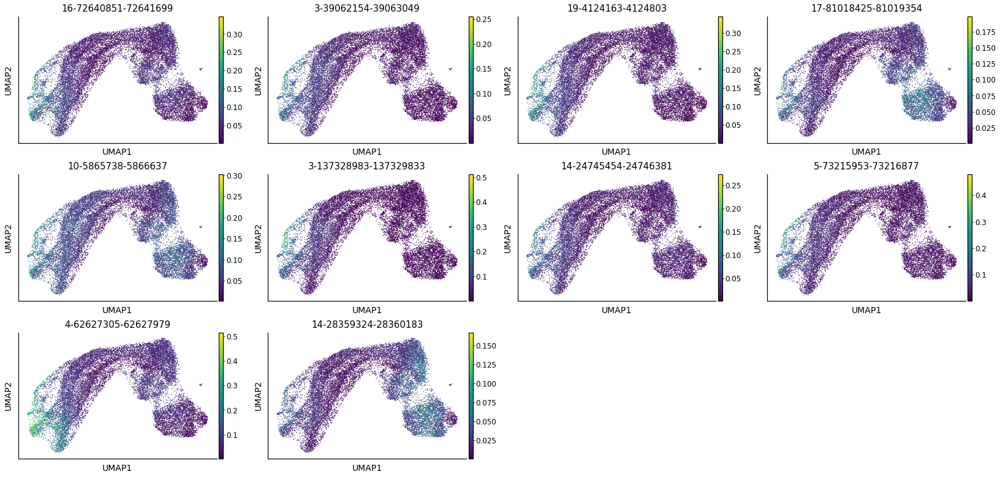

In [56]:
sc.pl.umap(adata, color=delta_drivers_peaks.index[:10], layer="ATAC_imputed")

# Epsilon

In [57]:
tp0.pull(14.5, 15.5, data="celltype", subset="Epsilon", key_added="Epsilon_pull")

In [64]:
eps_drivers = tp0.compute_feature_correlation(obs_key="Epsilon_pull", layer="ATAC_imputed", features=genes)

In [65]:
eps_drivers

,Epsilon_pull_corr,Epsilon_pull_pval,Epsilon_pull_qval,Epsilon_pull_ci_low,Epsilon_pull_ci_high
Mboat4,0.578947,0.000000e+00,0.000000e+00,NaN,NaN
Lrrtm3,0.543595,0.000000e+00,0.000000e+00,NaN,NaN
Irs4,0.529842,0.000000e+00,0.000000e+00,NaN,NaN
Ghrl,0.465623,0.000000e+00,0.000000e+00,NaN,NaN
Ctnna3,0.451011,0.000000e+00,0.000000e+00,NaN,NaN
...,...,...,...,...,...
Igf1r,-0.132140,7.488514e-38,9.367503e-36,NaN,NaN
Npepl1,-0.135384,1.138920e-39,1.504503e-37,NaN,NaN
Stx16,-0.136010,5.015957e-40,6.686271e-38,NaN,NaN
Glis3,-0.137187,1.062119e-40,1.469232e-38,NaN,NaN


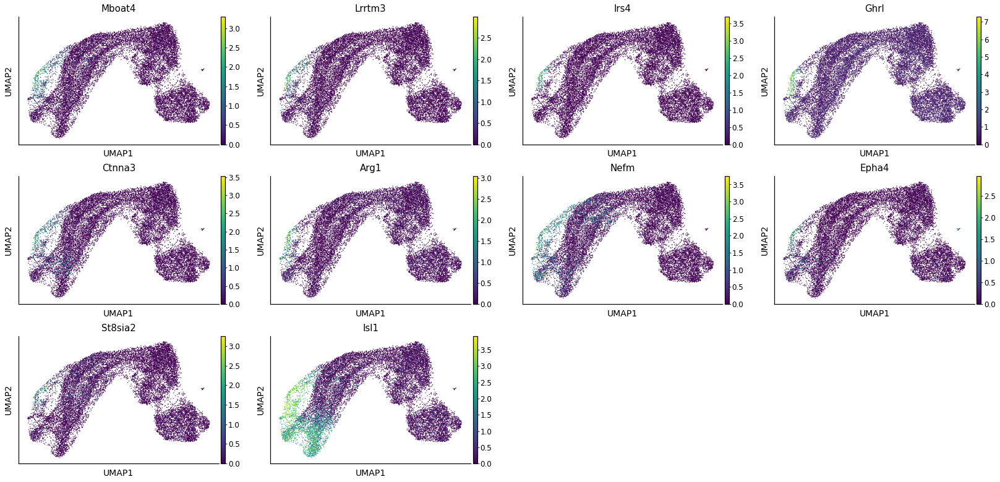

In [66]:
sc.pl.umap(adata, color=eps_drivers.index[:10], layer="ATAC_imputed")

In [67]:
eps_drivers_tfs = tp0.compute_feature_correlation(obs_key="Epsilon_pull", layer="ATAC_imputed", features="mouse")

In [68]:
eps_drivers_tfs

,Epsilon_pull_corr,Epsilon_pull_pval,Epsilon_pull_qval,Epsilon_pull_ci_low,Epsilon_pull_ci_high
Arg1,0.427761,0.000000e+00,0.000000e+00,NaN,NaN
Isl1,0.344856,3.071414e-265,2.039419e-262,NaN,NaN
Nuak2,0.279638,4.669982e-170,2.067245e-167,NaN,NaN
Arx,0.267124,1.306372e-154,4.337156e-152,NaN,NaN
Mctp2,0.252673,8.024535e-138,2.131317e-135,NaN,NaN
...,...,...,...,...,...
Sox5,-0.090203,2.102625e-18,1.163453e-16,NaN,NaN
Pax4,-0.101949,4.217079e-23,2.800140e-21,NaN,NaN
Prdm16,-0.104285,4.186559e-24,2.926184e-22,NaN,NaN
Glis3,-0.137187,1.062119e-40,1.084996e-38,NaN,NaN


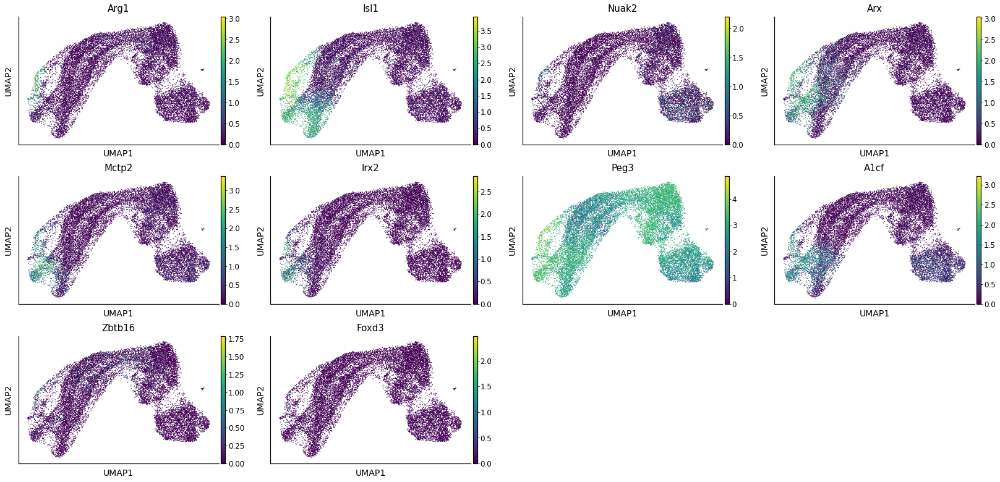

In [69]:
sc.pl.umap(adata, color=eps_drivers_tfs.index[:10], layer="ATAC_imputed")

In [70]:
eps_drivers_peaks = tp0.compute_feature_correlation(obs_key="Epsilon_pull", layer="ATAC_imputed", features=peaks)

In [71]:
eps_drivers_peaks

,Epsilon_pull_corr,Epsilon_pull_pval,Epsilon_pull_qval,Epsilon_pull_ci_low,Epsilon_pull_ci_high
10-64082077-64082994,0.504819,0.000000e+00,0.000000e+00,NaN,NaN
2-155892590-155893351,0.503065,0.000000e+00,0.000000e+00,NaN,NaN
4-57291831-57292786,0.494789,0.000000e+00,0.000000e+00,NaN,NaN
3-79085915-79086814,0.494417,0.000000e+00,0.000000e+00,NaN,NaN
9-11562792-11563740,0.489033,0.000000e+00,0.000000e+00,NaN,NaN
...,...,...,...,...,...
6-122723415-122724337,-0.191817,8.702109e-79,9.801831e-77,NaN,NaN
5-117995224-117996137,-0.203801,5.583540e-89,7.521399e-87,NaN,NaN
15-34215309-34216182,-0.210116,1.259111e-94,1.897202e-92,NaN,NaN
9-65820073-65820866,-0.211458,7.504737e-96,1.157127e-93,NaN,NaN


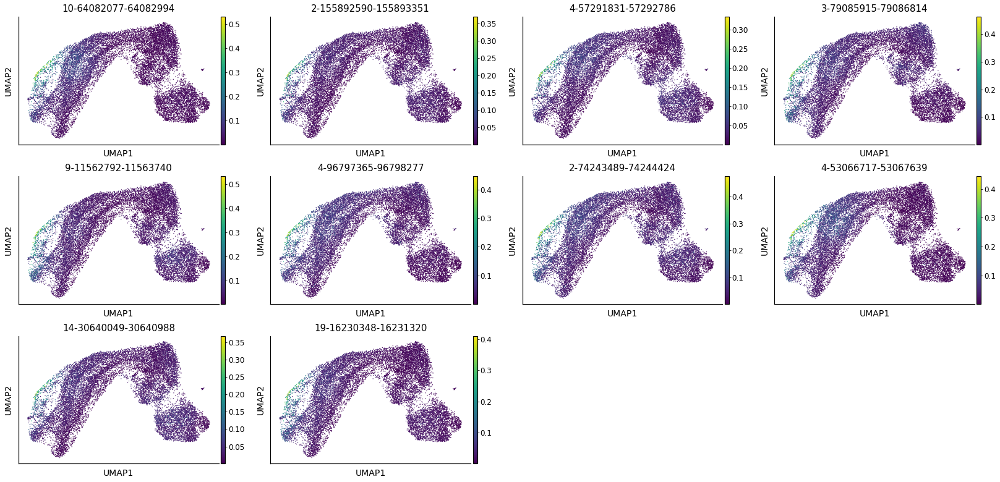

In [72]:
sc.pl.umap(adata, color=eps_drivers_peaks.index[:10], layer="ATAC_imputed")

In [73]:
eps_candidates = [
    "Slco5a1",
    "Lgals3",
    "Uap1l1",
    "Bhlhe41",
    "Lrrtm3",
    "Enpp1",
    "Gucy1a2",
    "Unc13d",
    "Lrrc9",
]
eps_c_present = list(set(eps_candidates).intersection(set(eps_drivers.index)))

In [74]:
eps_c_present

['Lrrtm3',
 'Enpp1',
 'Slco5a1',
 'Lrrc9',
 'Lgals3',
 'Uap1l1',
 'Unc13d',
 'Gucy1a2',
 'Bhlhe41']

In [75]:
eps_drivers.loc[eps_c_present]

,Epsilon_pull_corr,Epsilon_pull_pval,Epsilon_pull_qval,Epsilon_pull_ci_low,Epsilon_pull_ci_high
Lrrtm3,0.543595,0.000000e+00,0.000000e+00,NaN,NaN
Enpp1,0.278336,2.071514e-168,1.380664e-165,NaN,NaN
Slco5a1,0.152181,8.088387e-50,1.379070e-47,NaN,NaN
Lrrc9,-0.004692,6.498184e-01,8.214041e-01,NaN,NaN
Lgals3,0.121607,2.902277e-32,2.975951e-30,NaN,NaN
Uap1l1,0.190527,9.902095e-78,2.639899e-75,NaN,NaN
Unc13d,-0.004398,6.704315e-01,8.342275e-01,NaN,NaN
Gucy1a2,-0.012341,2.324195e-01,4.702591e-01,NaN,NaN
Bhlhe41,0.048900,2.187779e-06,3.712893e-05,NaN,NaN


# Epsilon progenitors

In [76]:
tp0.pull(14.5, 15.5, data="celltype", subset="Eps. progenitors", key_added="Eps_progenitors_pull")

In [77]:
eps_prog_drivers = tp0.compute_feature_correlation(obs_key="Eps_progenitors_pull", layer="ATAC_imputed", features=genes)

In [78]:
eps_prog_drivers

,Eps_progenitors_pull_corr,Eps_progenitors_pull_pval,Eps_progenitors_pull_qval,Eps_progenitors_pull_ci_low,Eps_progenitors_pull_ci_high
Gm38655,0.246045,1.723501e-130,2.527170e-126,NaN,NaN
Nefm,0.245099,1.834857e-129,1.345225e-125,NaN,NaN
Fam107b,0.236033,7.617986e-120,3.723417e-116,NaN,NaN
Cdkn1a,0.217420,2.131104e-101,7.812095e-98,NaN,NaN
Kcnh8,0.185772,6.660684e-74,1.953312e-70,NaN,NaN
...,...,...,...,...,...
Hmgn3,-0.119182,4.806632e-31,1.258565e-28,NaN,NaN
Abcc8,-0.120387,1.200553e-31,3.200675e-29,NaN,NaN
Pax6,-0.121484,3.350265e-32,9.268857e-30,NaN,NaN
Chgb,-0.136781,1.818288e-40,9.193642e-38,NaN,NaN


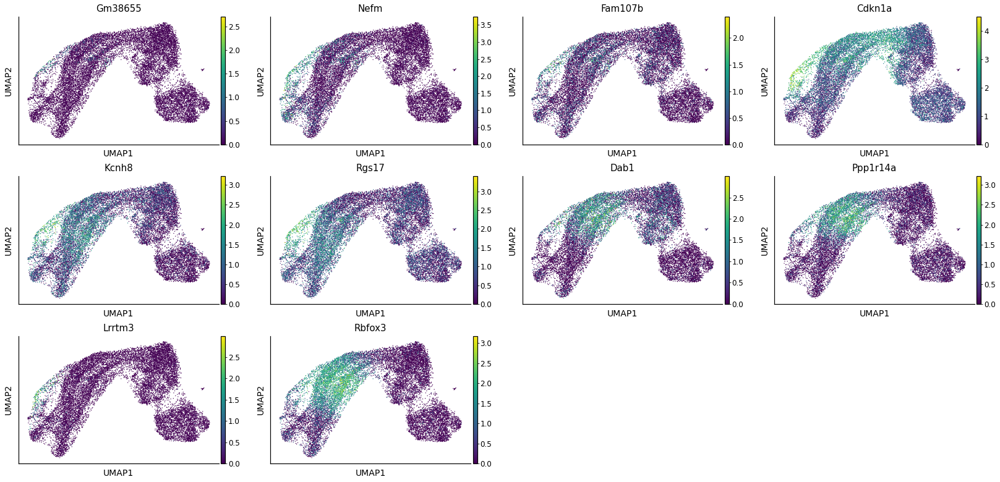

In [80]:
sc.pl.umap(adata, color=eps_prog_drivers.index[:10], layer="ATAC_imputed")

In [81]:
eps_prog_drivers_tf = tp0.compute_feature_correlation(obs_key="Eps_progenitors_pull", layer="ATAC_imputed", features="mouse")

In [82]:
eps_prog_drivers_tf

,Eps_progenitors_pull_corr,Eps_progenitors_pull_pval,Eps_progenitors_pull_qval,Eps_progenitors_pull_ci_low,Eps_progenitors_pull_ci_high
Neurod2,0.139063,8.699624e-42,1.155310e-38,NaN,NaN
Prox1,0.135603,8.558232e-40,5.682666e-37,NaN,NaN
Nkx2-2,0.133642,1.092884e-38,4.837832e-36,NaN,NaN
Gadd45a,0.107699,1.300703e-25,2.878889e-23,NaN,NaN
Setbp1,0.096868,5.343737e-21,8.870603e-19,NaN,NaN
...,...,...,...,...,...
Fev,-0.092039,4.230684e-19,5.618349e-17,NaN,NaN
Mlxipl,-0.095548,1.805157e-20,2.663609e-18,NaN,NaN
Tagln2,-0.097249,3.749069e-21,7.112520e-19,NaN,NaN
Hmgn3,-0.119182,4.806632e-31,1.276642e-28,NaN,NaN


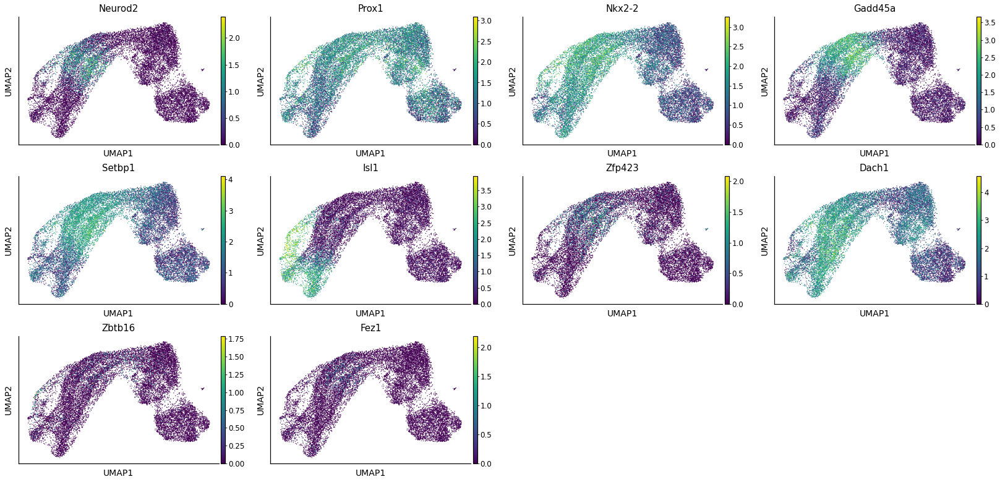

In [84]:
sc.pl.umap(adata, color=eps_prog_drivers_tf.index[:10], layer="ATAC_imputed")

In [85]:
eps_prog_drivers_peaks = tp0.compute_feature_correlation(obs_key="Eps_progenitors_pull", layer="ATAC_imputed", features=peaks)

In [86]:
eps_prog_drivers_peaks

,Eps_progenitors_pull_corr,Eps_progenitors_pull_pval,Eps_progenitors_pull_qval,Eps_progenitors_pull_ci_low,Eps_progenitors_pull_ci_high
14-79596355-79597272,0.260005,3.351667e-146,4.216933e-141,NaN,NaN
12-27615808-27616636,0.250653,1.454970e-135,9.152924e-131,NaN,NaN
5-150823073-150823955,0.249905,9.868172e-135,4.138580e-130,NaN,NaN
7-136365546-136366501,0.248653,2.390622e-133,7.519461e-129,NaN,NaN
6-16486958-16487859,0.245785,3.303373e-130,8.312343e-126,NaN,NaN
...,...,...,...,...,...
16-97658958-97659867,-0.143118,3.447002e-44,1.239108e-41,NaN,NaN
10-99555744-99556615,-0.143584,1.807724e-44,6.669812e-42,NaN,NaN
10-59577711-59578600,-0.144969,2.613999e-45,1.034223e-42,NaN,NaN
9-120902362-120903269,-0.147607,6.229826e-47,2.799328e-44,NaN,NaN


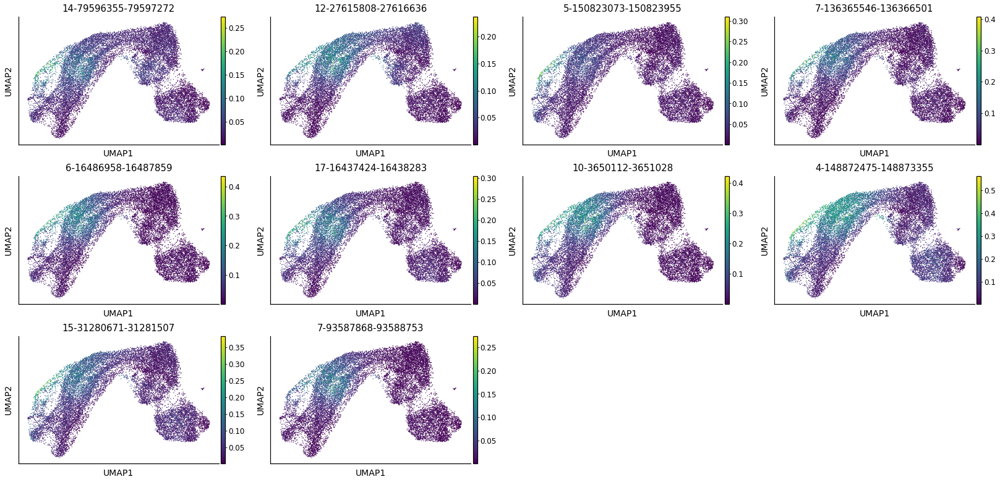

In [87]:
sc.pl.umap(adata, color=eps_prog_drivers_peaks.index[:10], layer="ATAC_imputed")

# Fev+ Delta

In [88]:
tp0.pull(14.5, 15.5, data="celltype", subset="Fev+ Delta", key_added="Fev_delta_pull")

In [89]:
fev_delta_drivers =  tp0.compute_feature_correlation(obs_key="Fev_delta_pull", layer="ATAC_imputed", features=genes)

In [90]:
fev_delta_drivers

,Fev_delta_pull_corr,Fev_delta_pull_pval,Fev_delta_pull_qval,Fev_delta_pull_ci_low,Fev_delta_pull_ci_high
Mboat4,0.220644,1.805233e-104,2.647013e-100,NaN,NaN
Isl1,0.193493,3.591008e-80,2.632747e-76,NaN,NaN
Nefm,0.172655,6.903913e-64,3.374403e-60,NaN,NaN
Cdkn1a,0.171136,8.875539e-63,3.253551e-59,NaN,NaN
Rgs17,0.164306,6.374145e-58,1.869282e-54,NaN,NaN
...,...,...,...,...,...
Ptprf,-0.079680,1.109976e-14,3.070864e-12,NaN,NaN
Vim,-0.083448,5.818720e-16,1.984183e-13,NaN,NaN
Ttr,-0.083626,5.045003e-16,1.804265e-13,NaN,NaN
Airn,-0.088259,1.109580e-17,4.785229e-15,NaN,NaN


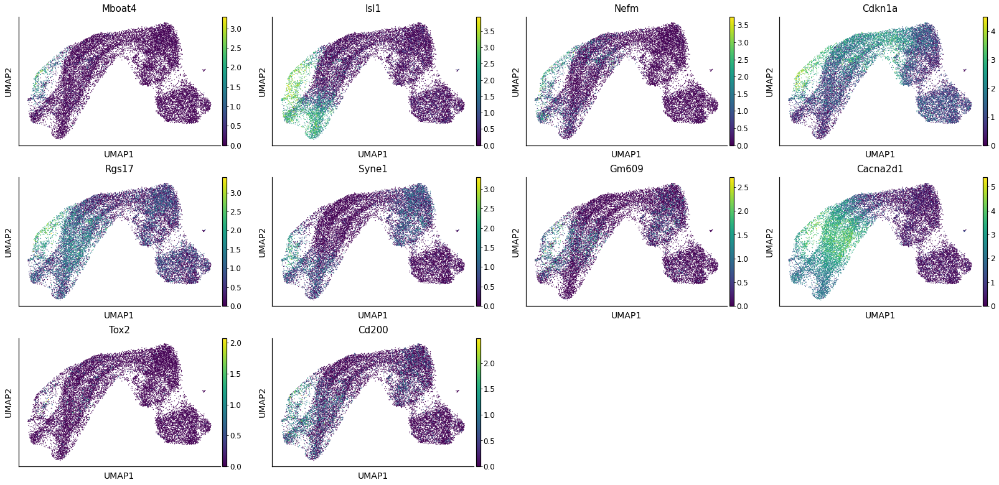

In [92]:
sc.pl.umap(adata, color=fev_delta_drivers.index[:10], layer="ATAC_imputed")

In [93]:
fev_delta_drivers_tfs = tp0.compute_feature_correlation(obs_key="Fev_delta_pull", layer="ATAC_imputed", features="mouse")

In [94]:
fev_delta_drivers_tfs

,Fev_delta_pull_corr,Fev_delta_pull_pval,Fev_delta_pull_qval,Fev_delta_pull_ci_low,Fev_delta_pull_ci_high
Isl1,0.193493,3.591008e-80,4.768858e-77,NaN,NaN
Hhex,0.118833,7.166889e-31,4.758814e-28,NaN,NaN
Fhl2,0.103960,5.792258e-24,2.564040e-21,NaN,NaN
Peg3,0.103587,8.390059e-24,2.785499e-21,NaN,NaN
Pou3f4,0.078613,2.495280e-14,6.627463e-12,NaN,NaN
...,...,...,...,...,...
Nfix,-0.050607,9.546421e-07,4.649984e-05,NaN,NaN
Mafb,-0.054967,1.015959e-07,6.132701e-06,NaN,NaN
Sox5,-0.056295,4.960907e-08,3.467413e-06,NaN,NaN
Rora,-0.058256,1.669861e-08,1.304456e-06,NaN,NaN


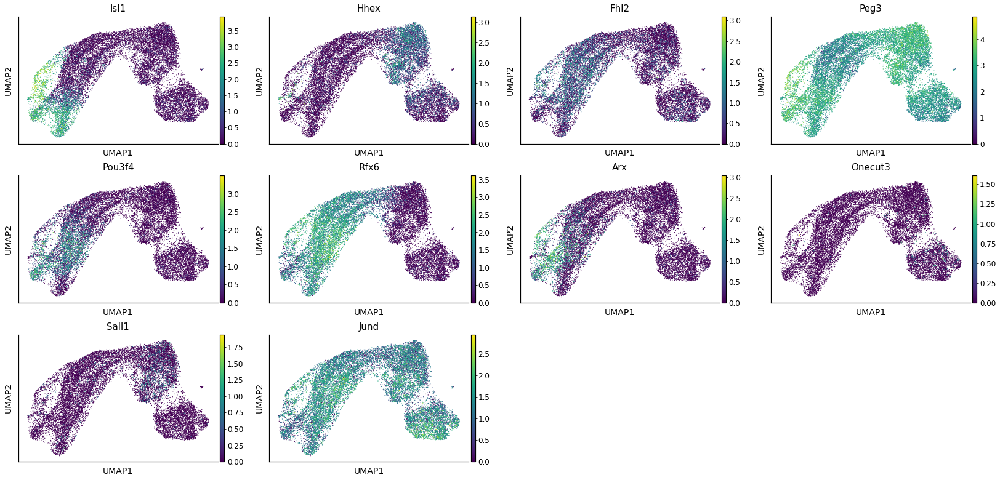

In [95]:
sc.pl.umap(adata, color=fev_delta_drivers_tfs.index[:10], layer="ATAC_imputed")

In [96]:
fev_delta_drivers_peaks = tp0.compute_feature_correlation(obs_key="Fev_delta_pull", layer="ATAC_imputed", features=peaks)

In [97]:
fev_delta_drivers_peaks

,Fev_delta_pull_corr,Fev_delta_pull_pval,Fev_delta_pull_qval,Fev_delta_pull_ci_low,Fev_delta_pull_ci_high
13-63992524-63993343,0.209319,6.663569e-94,8.383836e-89,NaN,NaN
10-69640253-69641178,0.208109,8.236709e-93,5.181549e-88,NaN,NaN
10-64082077-64082994,0.207002,8.111196e-92,3.401728e-87,NaN,NaN
8-69030907-69031818,0.202895,3.478221e-88,1.094040e-83,NaN,NaN
13-34956731-34957646,0.200222,7.279152e-86,1.831668e-81,NaN,NaN
...,...,...,...,...,...
2-5378859-5379756,-0.122324,1.251379e-32,1.648623e-30,NaN,NaN
16-57391106-57392008,-0.124957,5.458788e-34,8.166503e-32,NaN,NaN
17-36230967-36231885,-0.128094,1.195571e-35,2.089194e-33,NaN,NaN
13-9011382-9012253,-0.131877,1.046892e-37,2.202605e-35,NaN,NaN


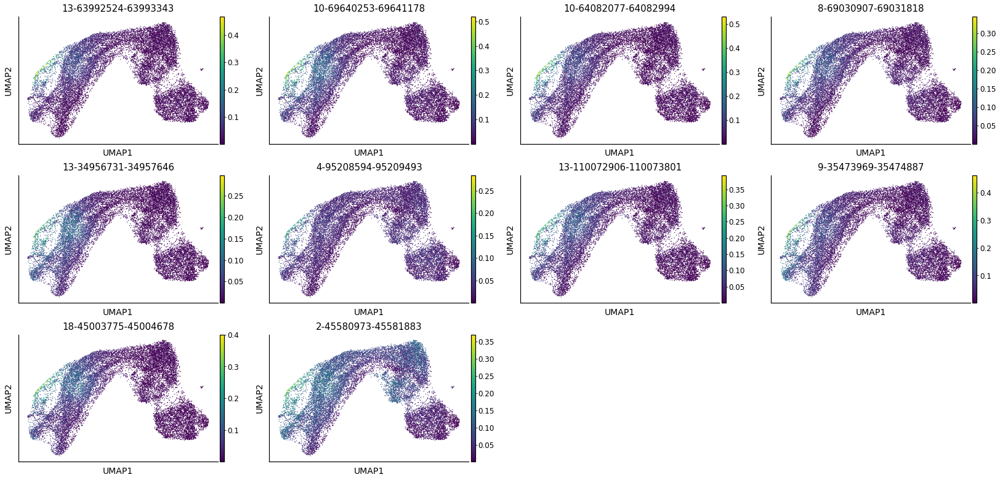

In [98]:
sc.pl.umap(adata, color=fev_delta_drivers_peaks.index[:10], layer="ATAC_imputed")

In [99]:
tp0.pull(14.5, 15.5, data="refinement", subset="Alpha", key_added="Alpha_pull")

In [103]:
alpha_drivers = tp0.compute_feature_correlation(obs_key="Alpha_pull", layer="ATAC_imputed", features=genes)

In [104]:
alpha_drivers 

,Alpha_pull_corr,Alpha_pull_pval,Alpha_pull_qval,Alpha_pull_ci_low,Alpha_pull_ci_high
Cltrn,0.618459,0.000000e+00,0.000000e+00,NaN,NaN
Gcg,0.608024,0.000000e+00,0.000000e+00,NaN,NaN
Pou6f2,0.587902,0.000000e+00,0.000000e+00,NaN,NaN
Gria2,0.575727,0.000000e+00,0.000000e+00,NaN,NaN
Irx2,0.569745,0.000000e+00,0.000000e+00,NaN,NaN
...,...,...,...,...,...
Neurog3,-0.263585,2.143487e-150,2.555280e-148,NaN,NaN
Btg2,-0.273806,9.436643e-163,1.281199e-160,NaN,NaN
Pard3,-0.275344,1.163510e-164,1.609485e-162,NaN,NaN
Nkx6-1,-0.279716,3.712226e-170,5.498220e-168,NaN,NaN


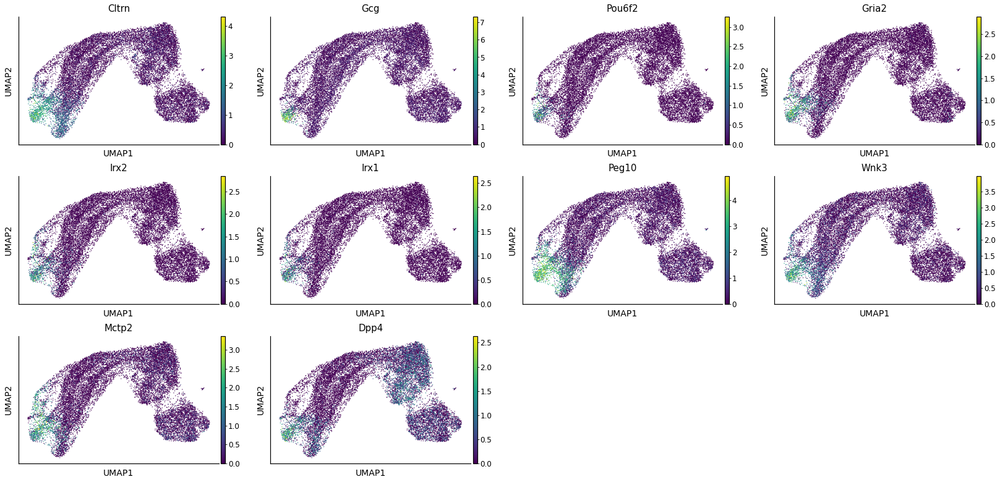

In [105]:
sc.pl.umap(adata, color=alpha_drivers.index[:10], layer="ATAC_imputed")

In [109]:
alpha_drivers_tfs = tp0.compute_feature_correlation(obs_key="Alpha_pull", layer="ATAC_imputed", features="mouse")

In [110]:
alpha_drivers_tfs

,Alpha_pull_corr,Alpha_pull_pval,Alpha_pull_qval,Alpha_pull_ci_low,Alpha_pull_ci_high
Pou6f2,0.587902,0.000000e+00,0.000000e+00,NaN,NaN
Irx2,0.569745,0.000000e+00,0.000000e+00,NaN,NaN
Irx1,0.552463,0.000000e+00,0.000000e+00,NaN,NaN
Mctp2,0.518803,0.000000e+00,0.000000e+00,NaN,NaN
Smarca1,0.460449,0.000000e+00,0.000000e+00,NaN,NaN
...,...,...,...,...,...
Hes6,-0.206523,2.169607e-91,1.309654e-89,NaN,NaN
Gadd45a,-0.208938,1.473612e-93,9.318840e-92,NaN,NaN
Neurog3,-0.263585,2.143487e-150,1.779094e-148,NaN,NaN
Nkx6-1,-0.279716,3.712226e-170,3.792182e-168,NaN,NaN


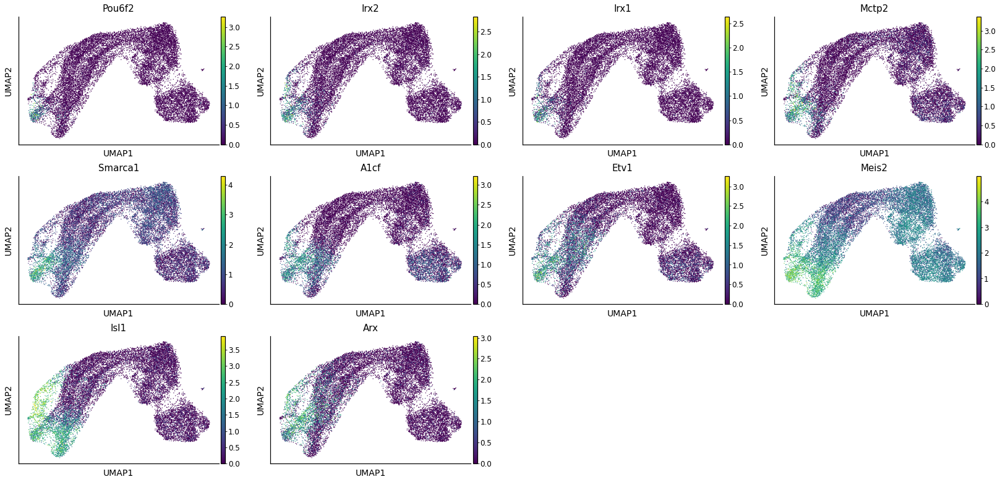

In [111]:
sc.pl.umap(adata, color=alpha_drivers_tfs.index[:10], layer="ATAC_imputed")

In [112]:
alpha_drivers_peaks = tp0.compute_feature_correlation(obs_key="Alpha_pull", layer="ATAC_imputed", features=peaks)

In [113]:
alpha_drivers_peaks

,Alpha_pull_corr,Alpha_pull_pval,Alpha_pull_qval,Alpha_pull_ci_low,Alpha_pull_ci_high
19-60167711-60168625,0.677910,0.000000e+00,0.000000e+00,NaN,NaN
14-93825518-93826591,0.666812,0.000000e+00,0.000000e+00,NaN,NaN
3-154084552-154085465,0.666098,0.000000e+00,0.000000e+00,NaN,NaN
16-70767846-70768746,0.663499,0.000000e+00,0.000000e+00,NaN,NaN
3-17473827-17474733,0.656660,0.000000e+00,0.000000e+00,NaN,NaN
...,...,...,...,...,...
12-51345863-51346735,-0.335343,9.833471e-250,5.560485e-248,NaN,NaN
9-49980556-49981443,-0.335863,1.447631e-250,8.219095e-249,NaN,NaN
11-86586882-86587771,-0.336610,9.140407e-252,5.232072e-250,NaN,NaN
1-152815005-152815924,-0.344557,9.595526e-265,5.929621e-263,NaN,NaN


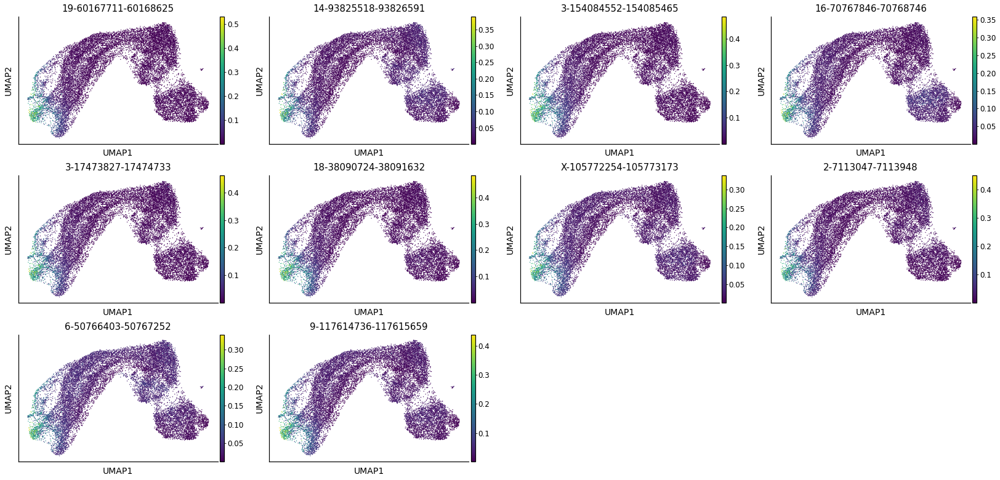

In [114]:
sc.pl.umap(adata, color=alpha_drivers_peaks.index[:10], layer="ATAC_imputed")

In [117]:
tp0.pull(14.5, 15.5, data="refinement", subset="Beta", key_added="Beta_pull")

In [121]:
beta_drivers = tp0.compute_feature_correlation(obs_key="Beta_pull", layer="ATAC_imputed", features=genes)

In [122]:
beta_drivers

,Beta_pull_corr,Beta_pull_pval,Beta_pull_qval,Beta_pull_ci_low,Beta_pull_ci_high
Papss2,0.684788,0.000000e+00,0.000000e+00,NaN,NaN
Phactr1,0.674214,0.000000e+00,0.000000e+00,NaN,NaN
Sntg1,0.655243,0.000000e+00,0.000000e+00,NaN,NaN
Ppp1r1a,0.641050,0.000000e+00,0.000000e+00,NaN,NaN
Mapt,0.632116,0.000000e+00,0.000000e+00,NaN,NaN
...,...,...,...,...,...
Rpl9,-0.320291,2.267911e-226,1.807303e-224,NaN,NaN
Rps3,-0.333975,1.493864e-247,1.395193e-245,NaN,NaN
Sox4,-0.336933,2.766662e-252,2.722655e-250,NaN,NaN
Neurog3,-0.368789,6.678736e-307,7.961813e-305,NaN,NaN


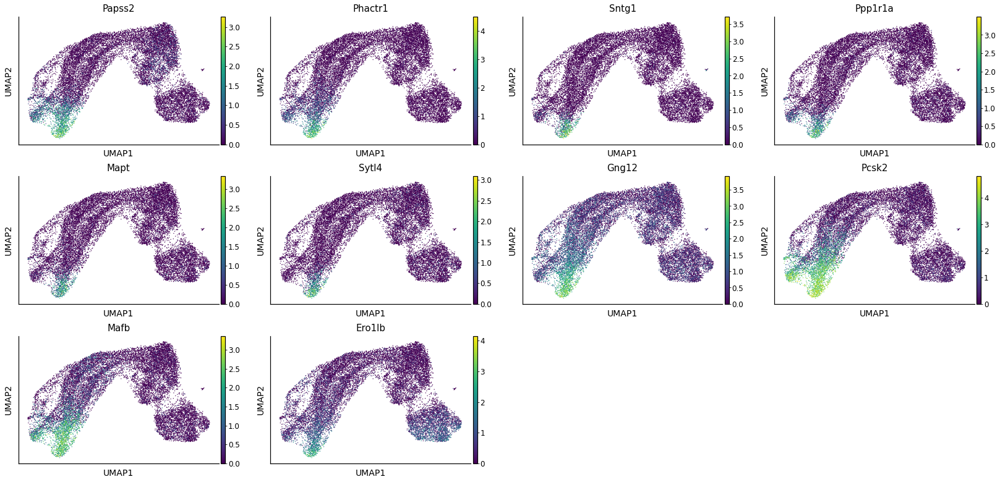

In [123]:
sc.pl.umap(adata, color=beta_drivers.index[:10], layer="ATAC_imputed")

In [124]:
beta_drivers_tfs = tp0.compute_feature_correlation(obs_key="Beta_pull", layer="ATAC_imputed", features="mouse")

In [125]:
beta_drivers_tfs

,Beta_pull_corr,Beta_pull_pval,Beta_pull_qval,Beta_pull_ci_low,Beta_pull_ci_high
Mafb,0.609870,0.000000e+00,0.000000e+00,NaN,NaN
Pdx1,0.543066,0.000000e+00,0.000000e+00,NaN,NaN
Rora,0.523082,0.000000e+00,0.000000e+00,NaN,NaN
Mlxipl,0.487098,0.000000e+00,0.000000e+00,NaN,NaN
Mafa,0.437388,0.000000e+00,0.000000e+00,NaN,NaN
...,...,...,...,...,...
Cbfa2t2,-0.271616,4.682348e-160,2.220771e-158,NaN,NaN
Rps4x,-0.277174,5.997861e-167,3.186064e-165,NaN,NaN
Setbp1,-0.304830,8.131642e-204,5.142296e-202,NaN,NaN
Sox4,-0.336933,2.766662e-252,2.624377e-250,NaN,NaN


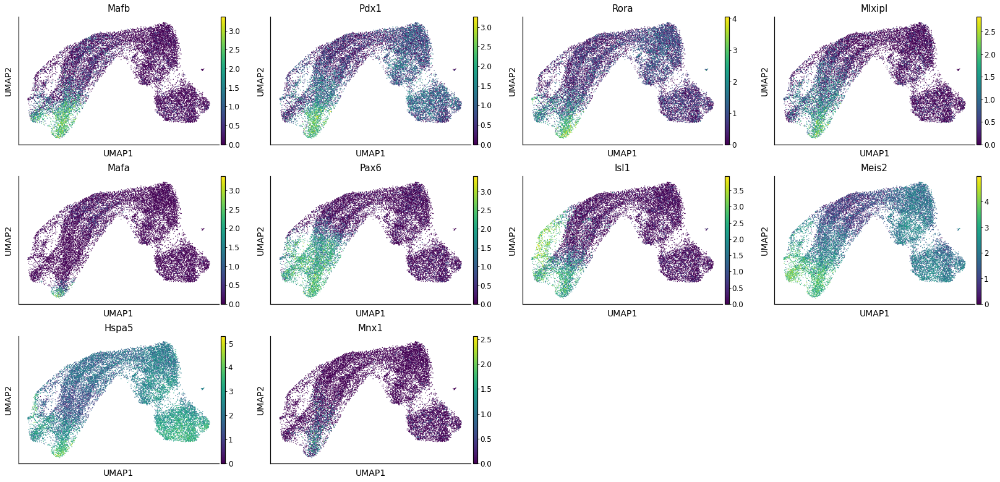

In [126]:
sc.pl.umap(adata, color=beta_drivers_tfs.index[:10], layer="ATAC_imputed")

In [130]:
beta_drivers_peaks = tp0.compute_feature_correlation(obs_key="Beta_pull", layer="ATAC_imputed", features=peaks)

In [131]:
beta_drivers_peaks

,Beta_pull_corr,Beta_pull_pval,Beta_pull_qval,Beta_pull_ci_low,Beta_pull_ci_high
10-20505031-20505953,0.787106,0.0,0.0,NaN,NaN
6-6536673-6537567,0.780205,0.0,0.0,NaN,NaN
10-76859043-76859925,0.775003,0.0,0.0,NaN,NaN
18-84450439-84451317,0.774762,0.0,0.0,NaN,NaN
14-121888845-121889756,0.772612,0.0,0.0,NaN,NaN
...,...,...,...,...,...
4-152572052-152572968,-0.441645,0.0,0.0,NaN,NaN
2-134214497-134215375,-0.446700,0.0,0.0,NaN,NaN
19-37434257-37435171,-0.447384,0.0,0.0,NaN,NaN
2-18893395-18894300,-0.452361,0.0,0.0,NaN,NaN


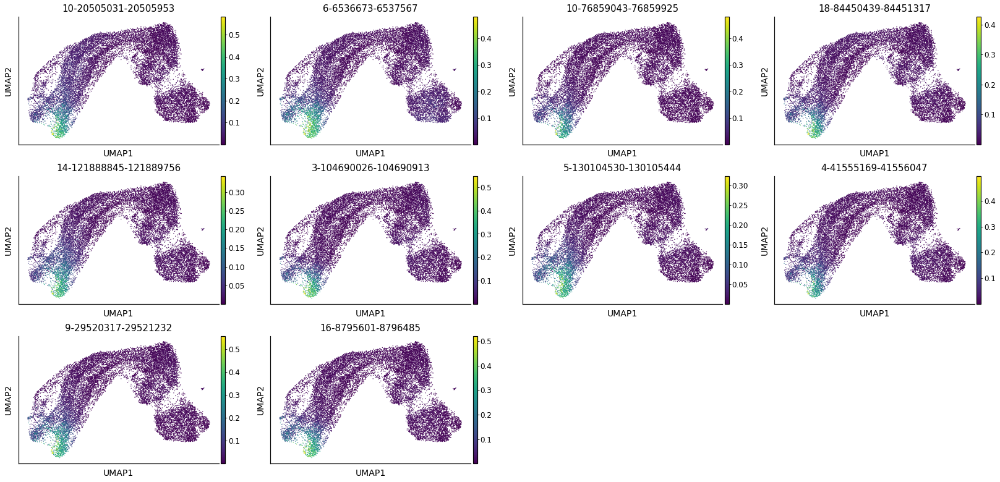

In [132]:
sc.pl.umap(adata, color=beta_drivers_peaks.index[:10], layer="ATAC_imputed")